In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

def cadence (dataset, reading):
    figure = plt.figure(figsize=(18, 12))
    for i in range(6):
        ax = plt.subplot(6, 1, i + 1)
        plt.imshow(reading[i].astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["ON", "OFF"][i % 2], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()

def diff_cadence (dataset, reading):
    figure = plt.figure(figsize=(18, 6))
    diff = []
    for i in [0,2,4]:
        diff.append(reading[i] - reading[i+1])
    for i in range(len(diff)):
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(diff[i].astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["DIFF-"+ str((i+1)*2-1) + "-"+ str((i+1)*2)], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()


train = pd.read_csv('./seti-breakthrough-listen/train_labels.csv')
print('Train shape is', train.shape )
train.head()

train['img_path']=train['id'].apply(lambda x:f'./seti-breakthrough-listen/train/{x[0]}/{x}.npy')
train.head()


#cadence('./seti-breakthrough-listen/train/0/0242546174808dd.npy')

Train shape is (60000, 2)


,id,target,img_path
0,0000799a2b2c42d,0,./seti-breakthrough-listen/train/0/0000799a2b2...
1,00042890562ff68,0,./seti-breakthrough-listen/train/0/00042890562...
2,0005364cdcb8e5b,0,./seti-breakthrough-listen/train/0/0005364cdcb...
3,0007a5a46901c56,0,./seti-breakthrough-listen/train/0/0007a5a4690...
4,0009283e145448e,0,./seti-breakthrough-listen/train/0/0009283e145...


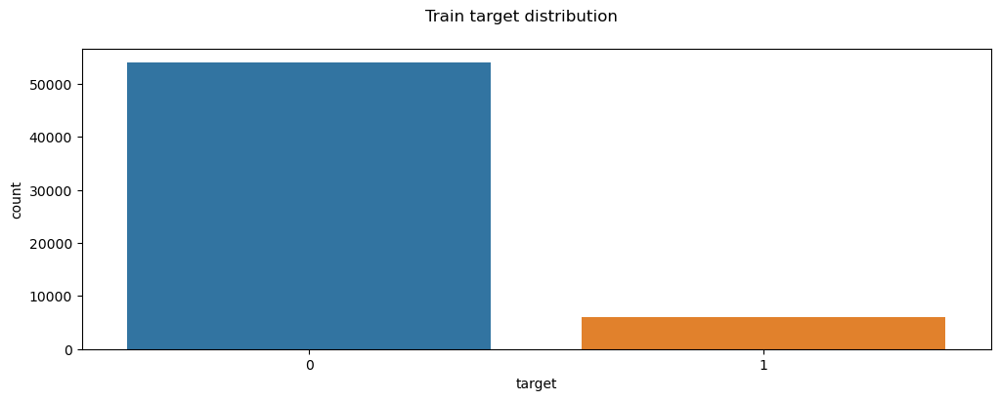

In [11]:
# Train 
import seaborn as sns
train_labels=pd.read_csv('./seti-breakthrough-listen/train_labels.csv')

cmap_plot = plt.get_cmap('jet_r')
ddt = train_labels.target.value_counts().to_frame()
fig, ax = plt.subplots(1, 1, figsize = (12, 4))
sns.countplot(data = train_labels, x = 'target', orient = "v", ax = ax)
plt.suptitle("Train target distribution")
plt.rcParams.update(plt.rcParamsDefault)

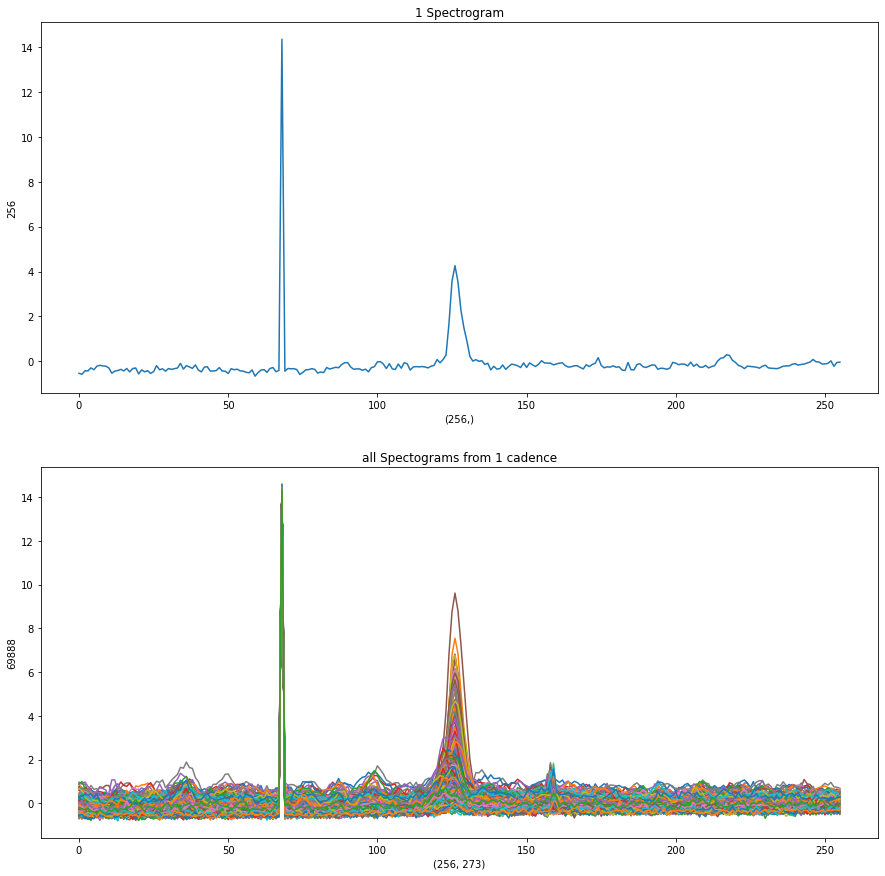

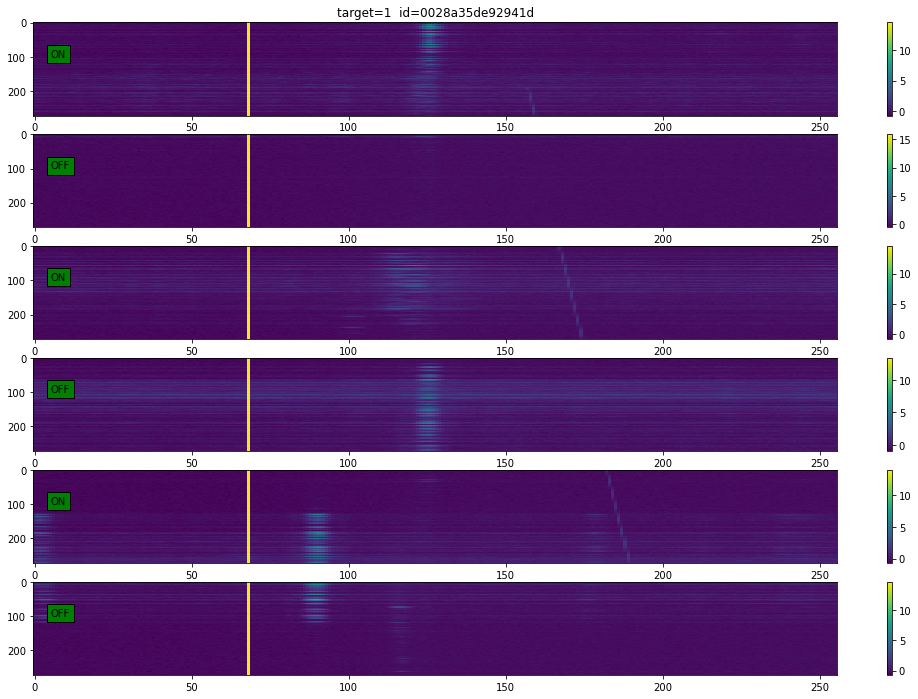

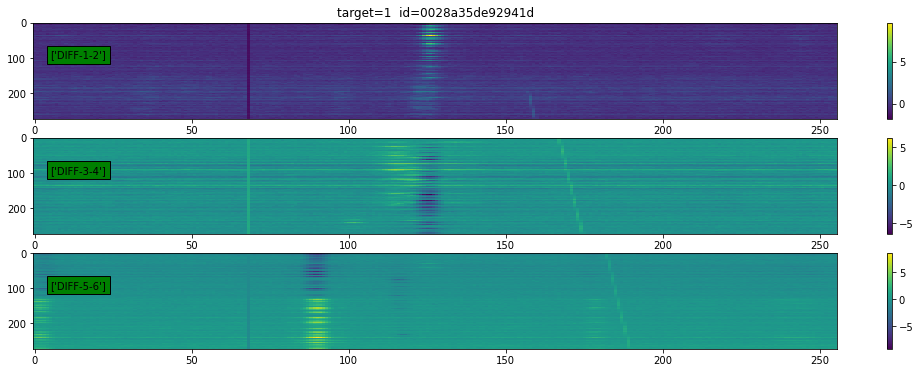

In [2]:
finding = train.loc[train['target'] == 1].iloc[1]
data = np.load(finding['img_path'])

figure,axis = plt.subplots(2,1,figsize=(15,15))
axis[0].set_title("1 Spectrogram")
axis[0].set_xlabel(data[0][0].shape)
axis[0].set_ylabel(data[0][0].size)
axis[0].plot(data[0][0])
axis[1].set_title("all Spectograms from 1 cadence")
axis[1].set_xlabel(data[0].T.shape)
axis[1].set_ylabel(data[0].T.size)
axis[1].plot(data[0].T)

cadence(finding, np.load(finding['img_path']))
diff_cadence(finding, np.load(finding['img_path']))

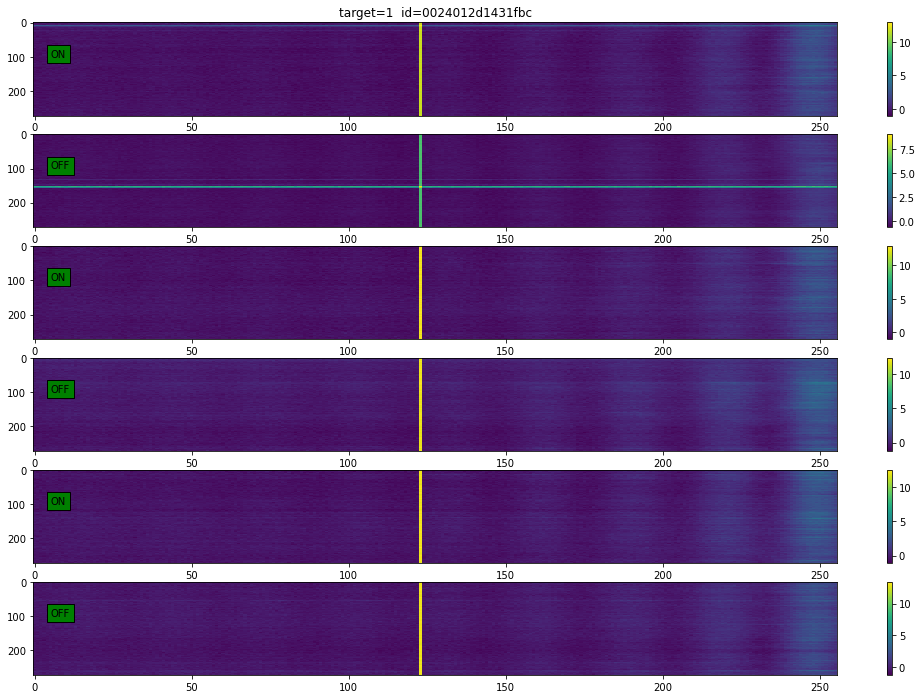

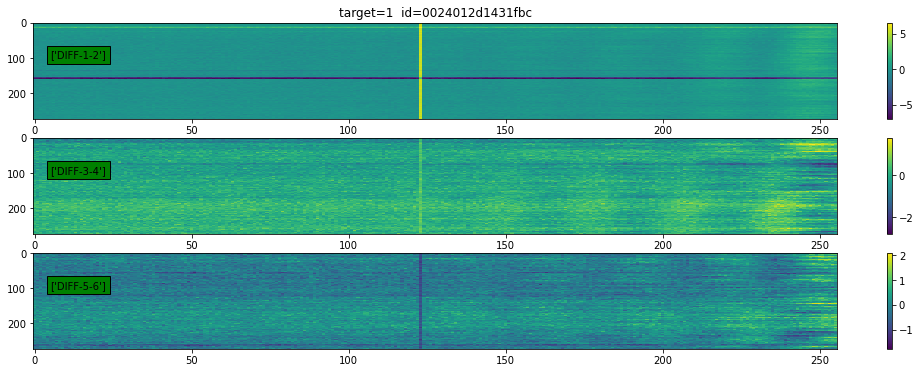

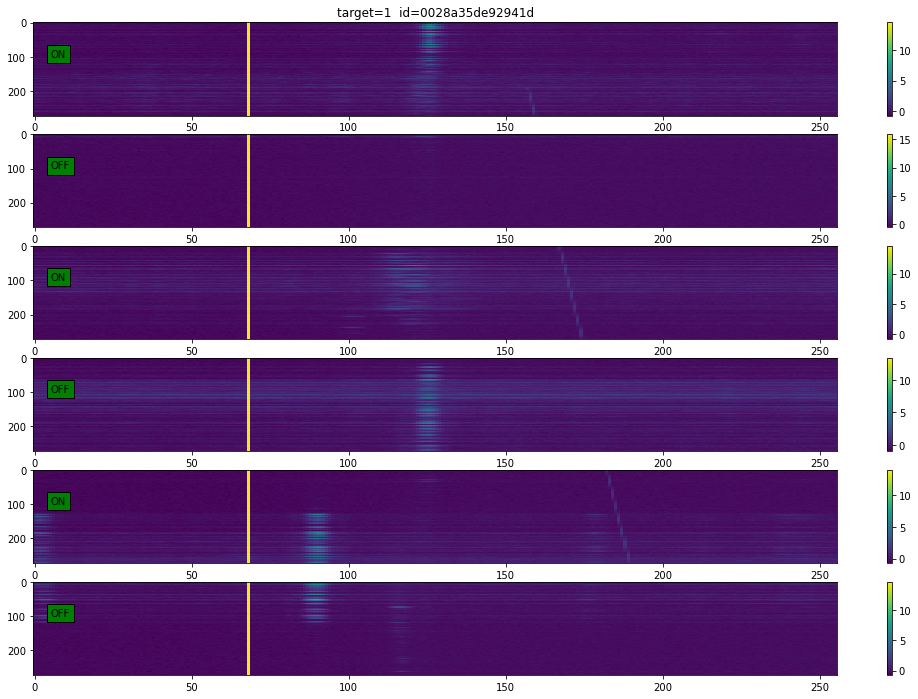

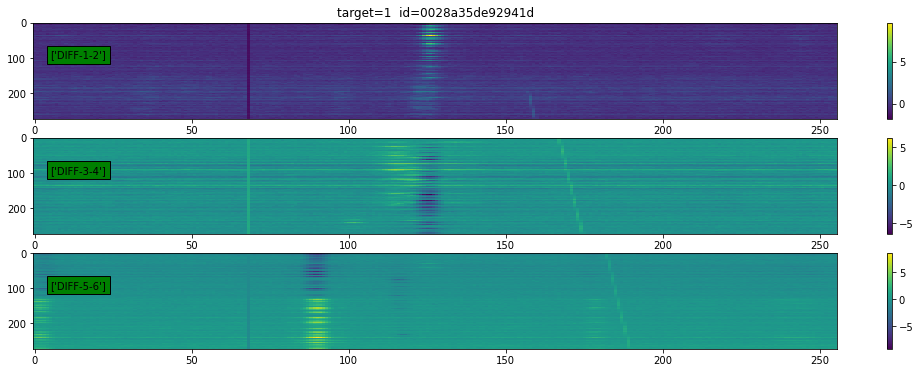

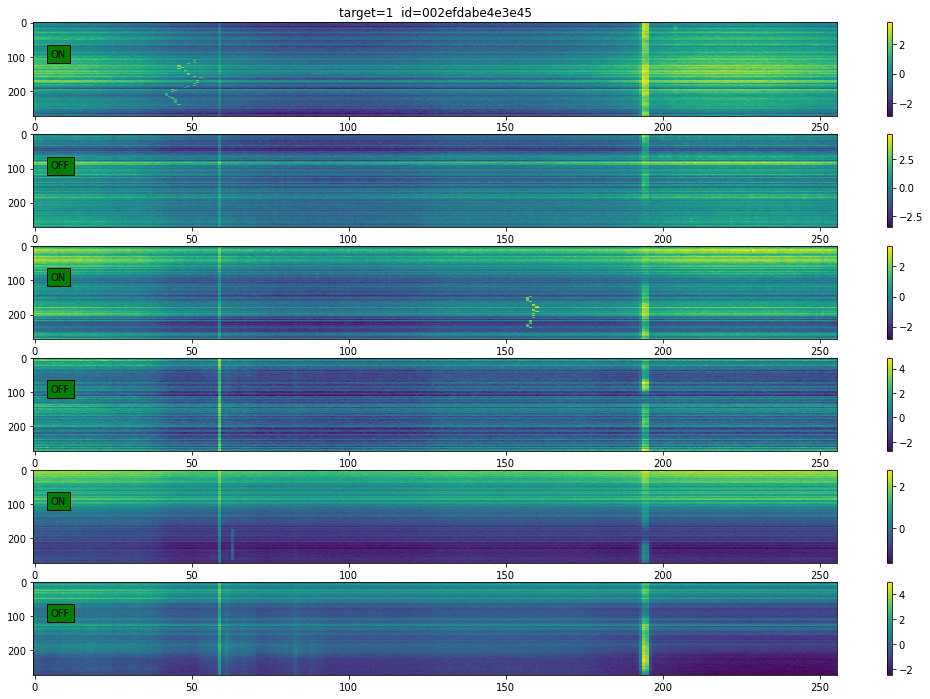

...

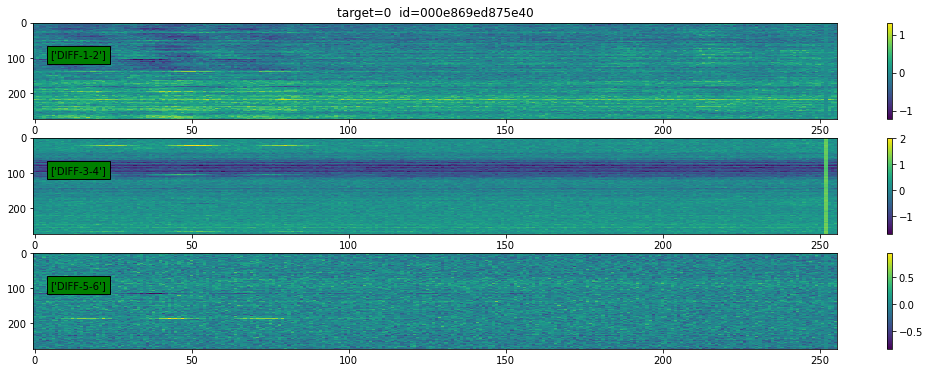

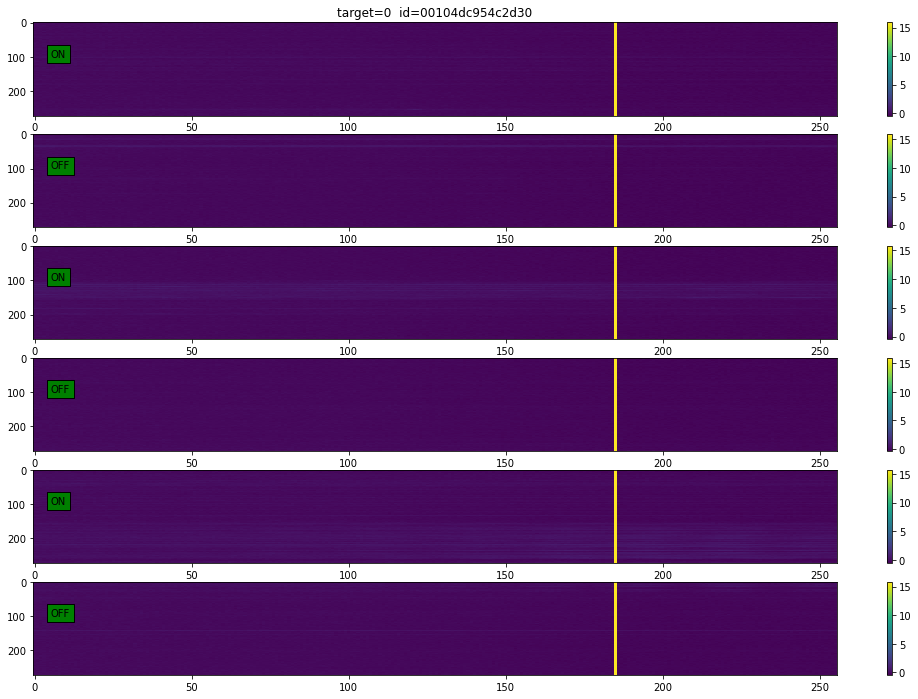

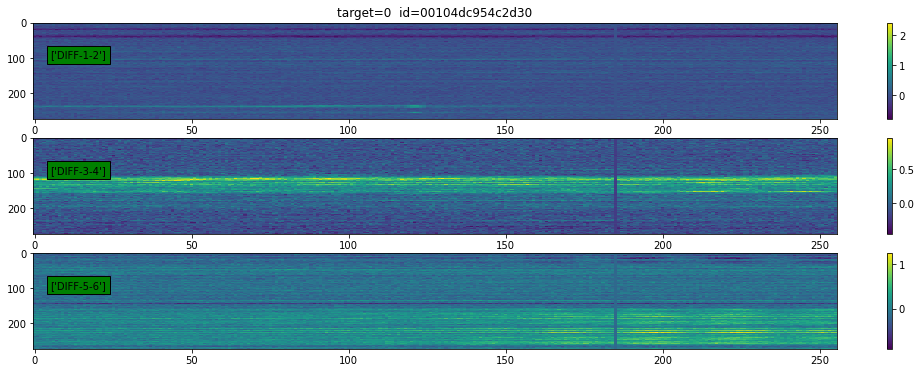

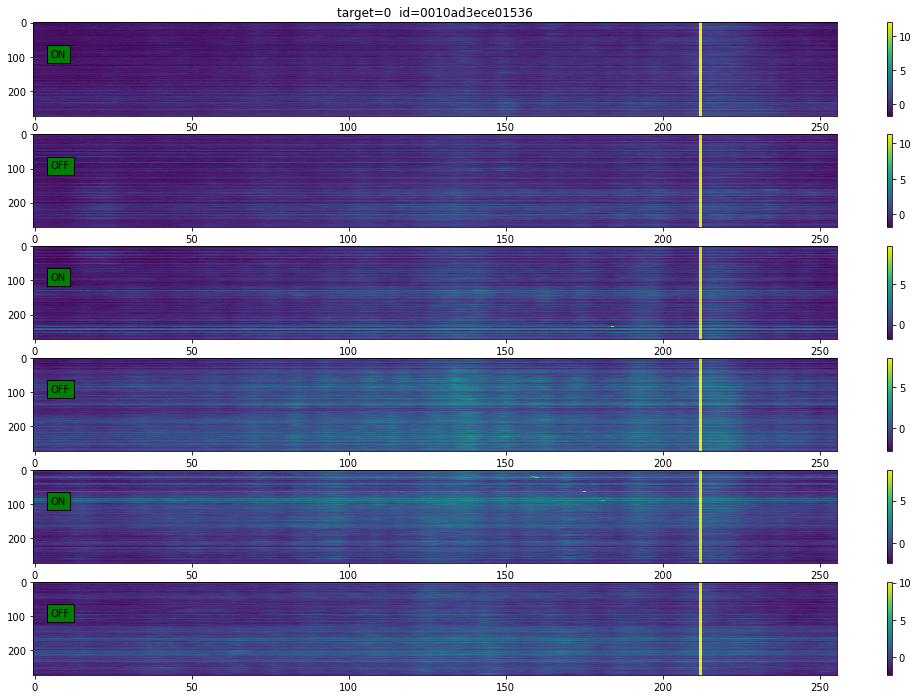

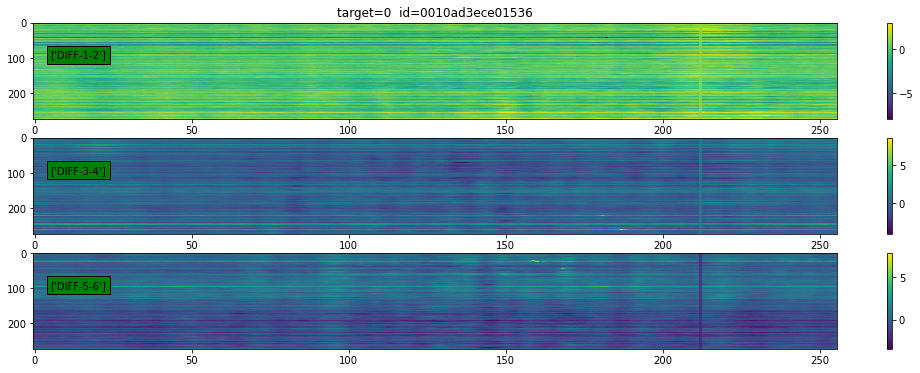

419328


In [3]:
for i in range(0,10):
    entry = train.loc[train['target'] == 1].iloc[i]
    cadence(entry, np.load(entry['img_path']))
    diff_cadence(entry, np.load(entry['img_path']))

for i in range(0,10):
    entry = train.loc[train['target'] == 0].iloc[i]
    cadence(entry, np.load(entry['img_path']))
    diff_cadence(entry, np.load(entry['img_path']))

#label targets and show a lot of data

In [6]:
print(np.load(entry['img_path']).shape)

(6, 273, 256)


filter out outliers (Seems to not be usefule with hard margin)

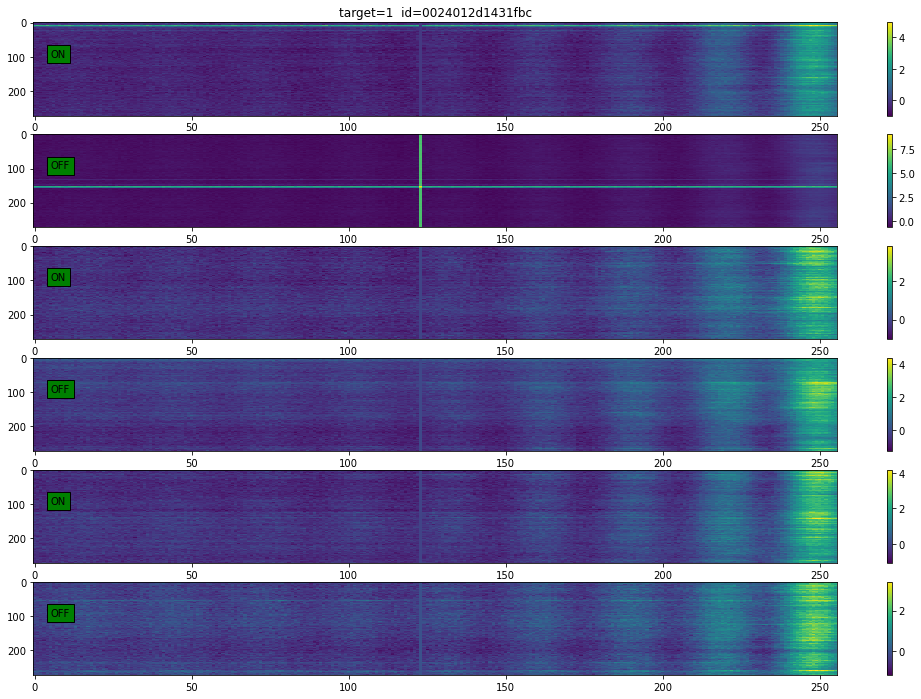

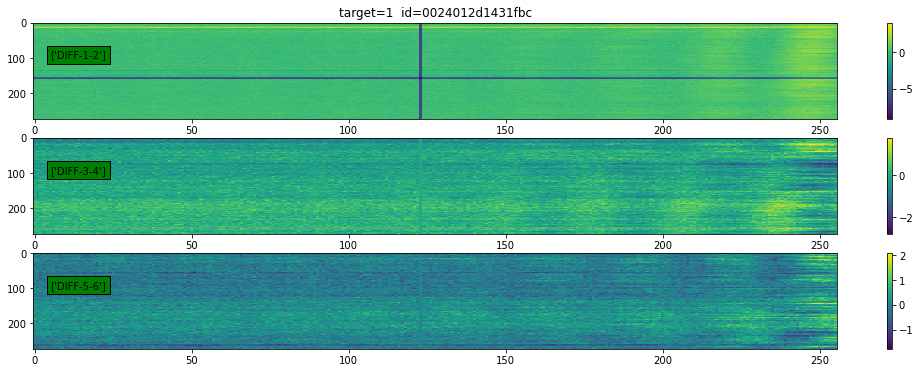

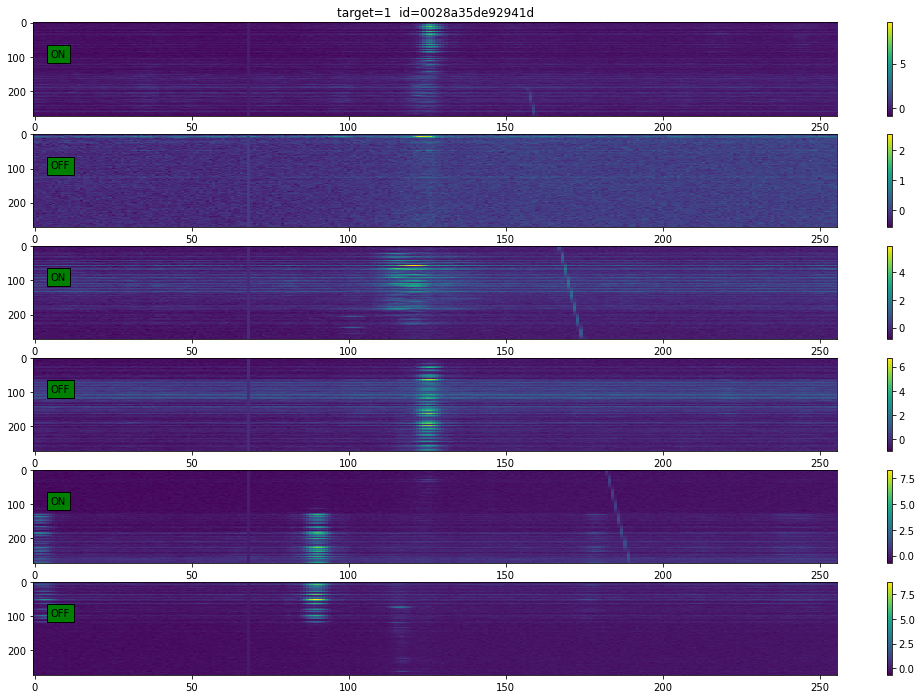

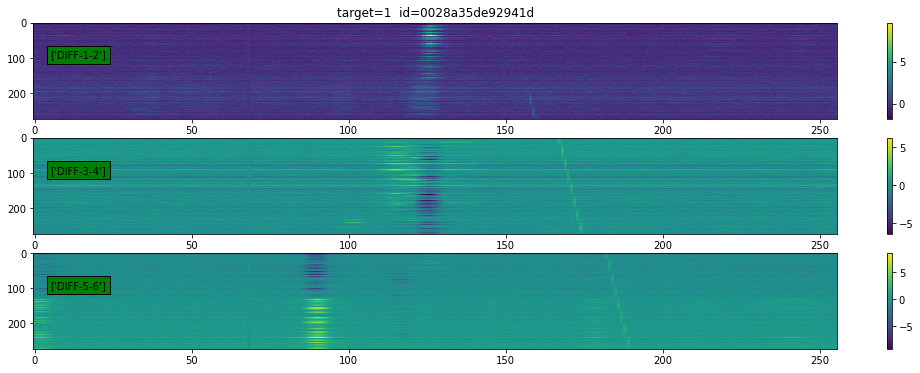

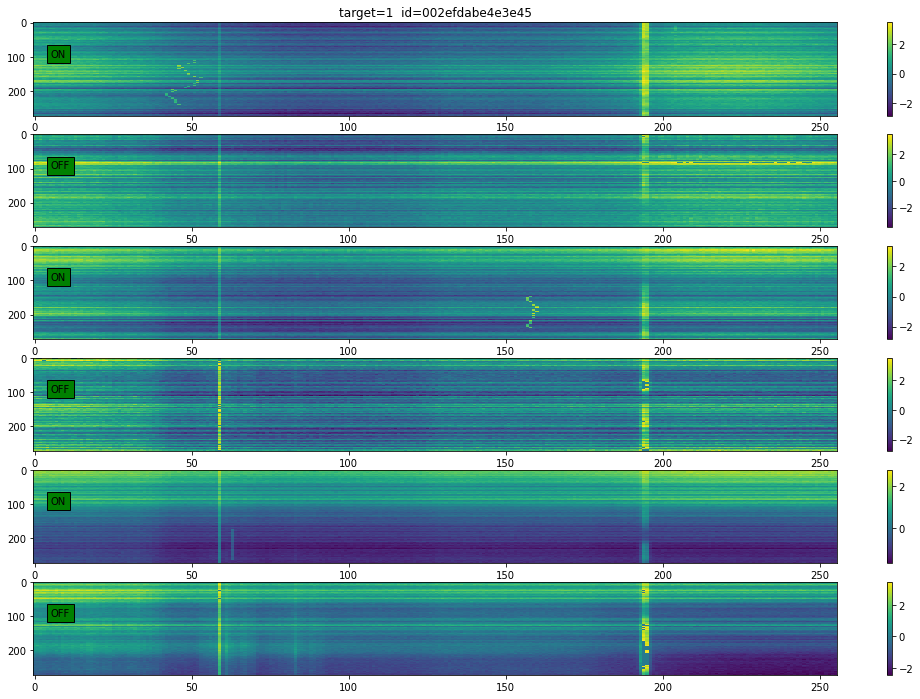

...

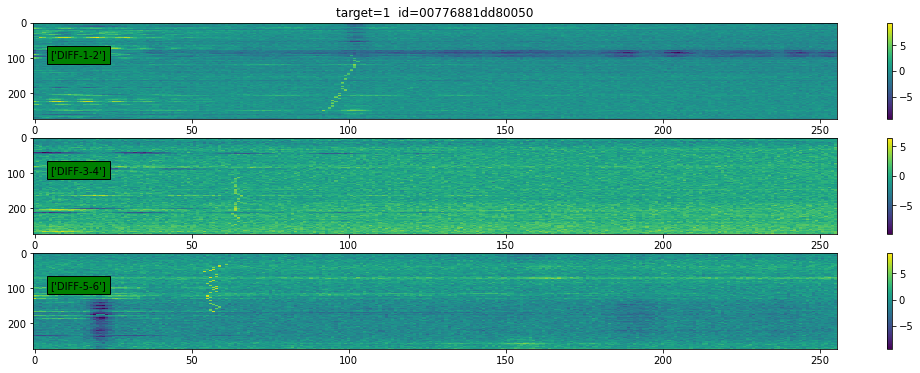

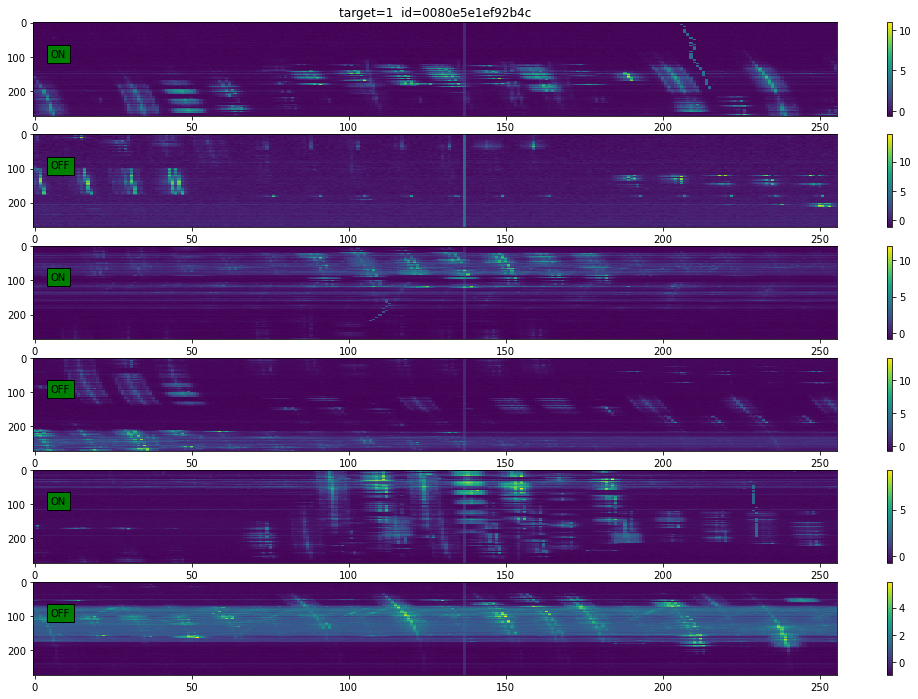

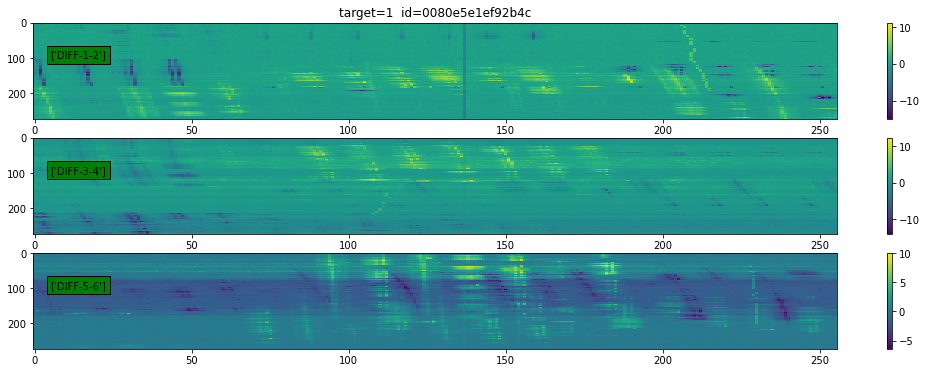

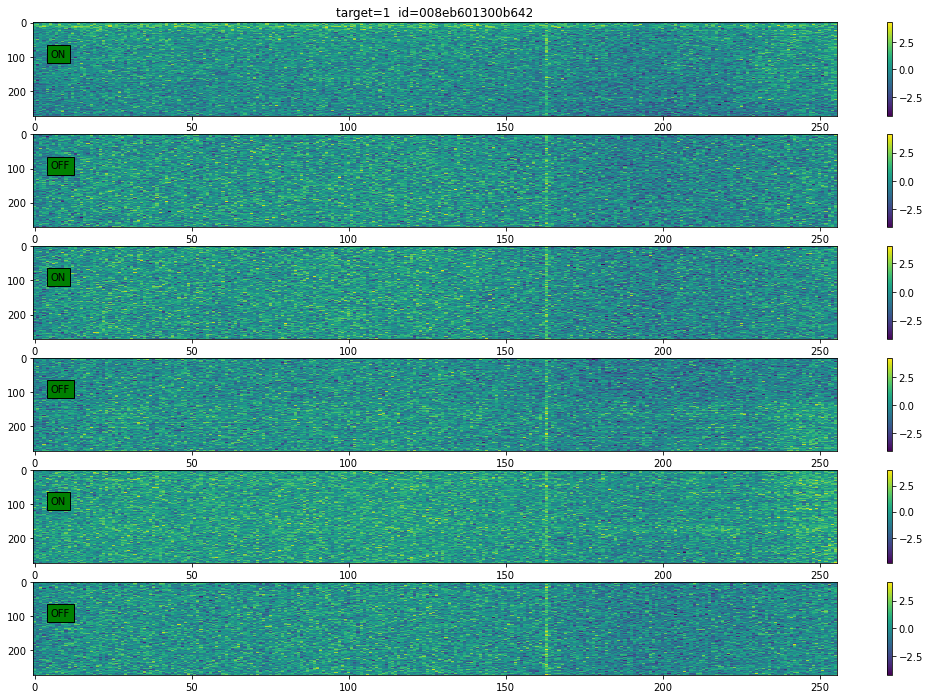

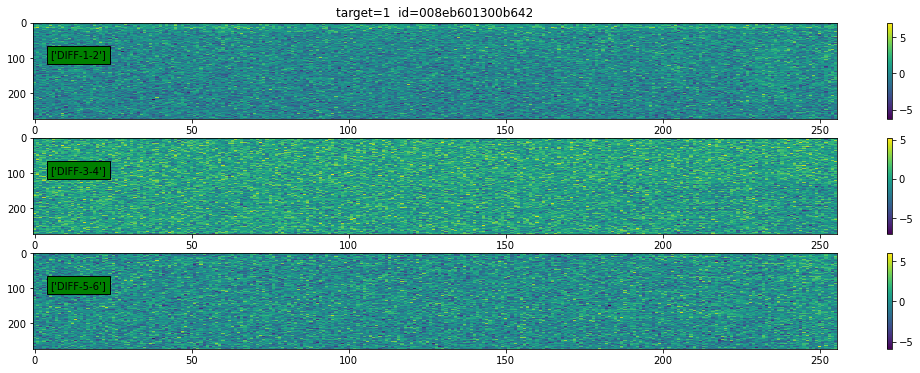

In [4]:
def cutoffOutliersAndLoadData (dataset, cutoff):
    reading = np.load(dataset['img_path'])
    max = np.amax(reading)
    for ix,iy,iz in np.ndindex(reading.shape):
        if reading[ix,iy,iz].any() and reading[ix,iy,iz] > max * cutoff:
            reading[ix,iy,iz] = 0
    return reading

for i in range(0,10):
    entry = train.loc[train['target'] == 1].iloc[i]
    data = cutoffOutliersAndLoadData(entry, 0.7)
    cadence(entry, data)
    diff_cadence(entry, data)

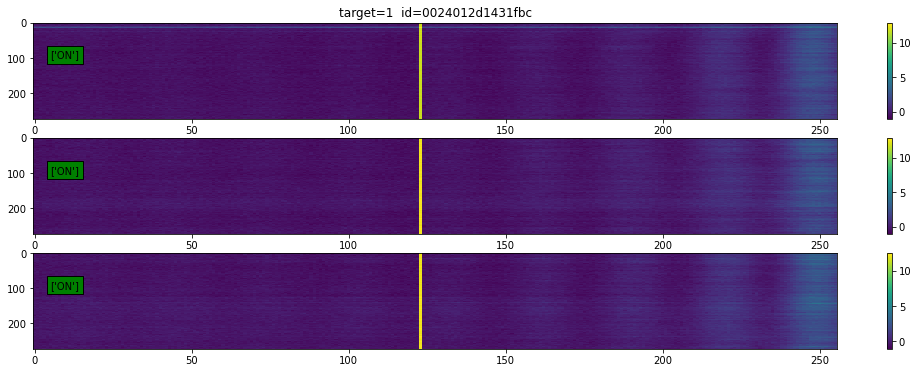

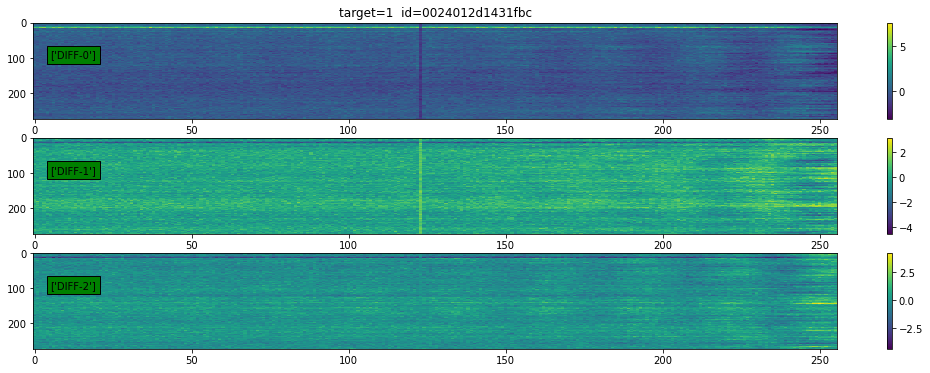

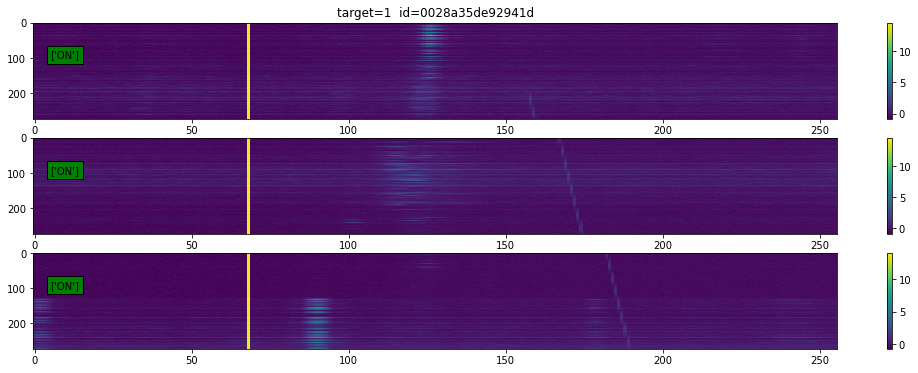

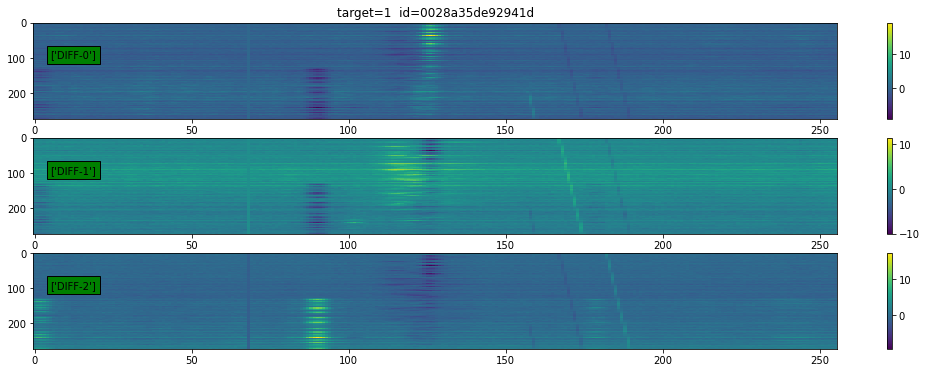

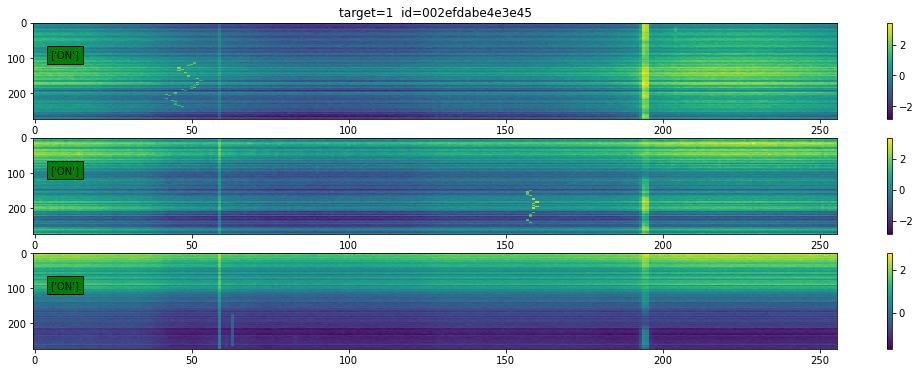

...

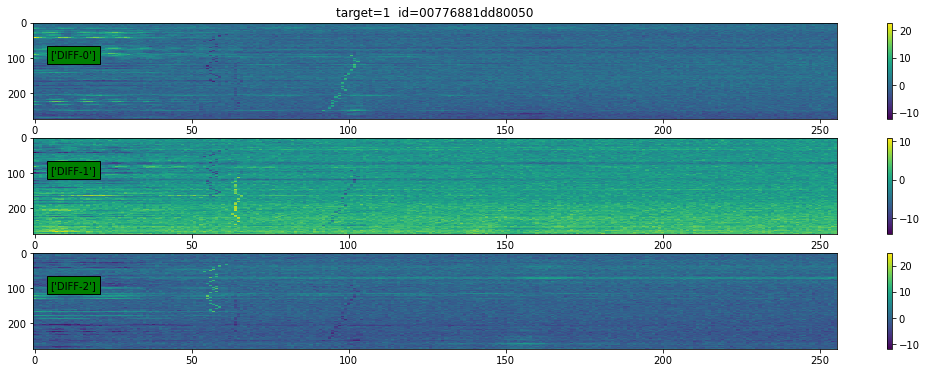

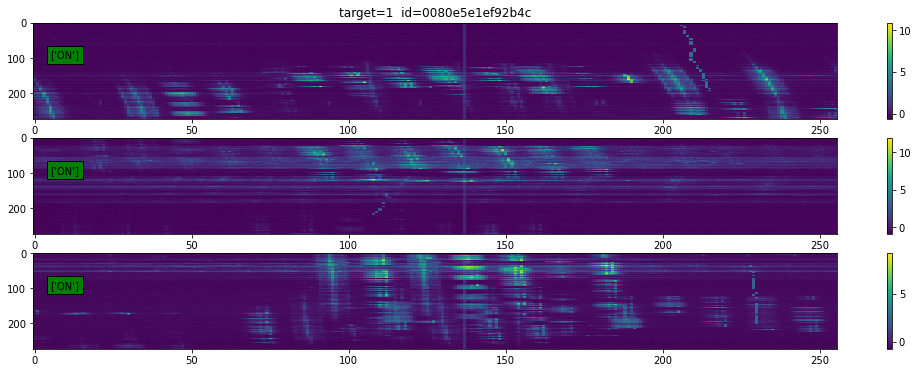

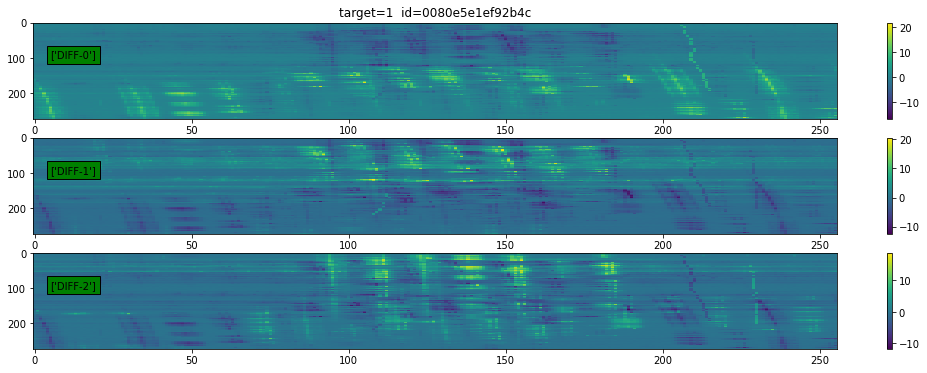

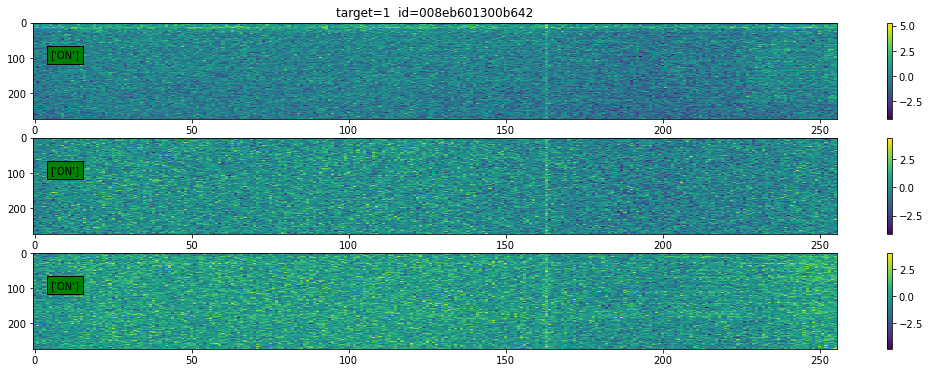

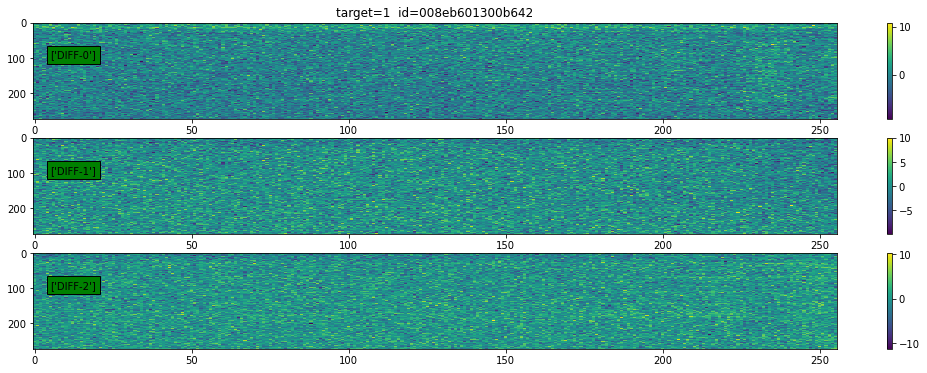

TypeError: draw_cadence_on() missing 1 required positional argument: 'reading'

In [5]:
def draw_cadence_on (dataset, reading):
    figure = plt.figure(figsize=(18,6))
    reading = np.take(reading, [0,2,4], 0)
    for i in range(3):
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(reading[i].astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["ON"], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()

def diff_cadence_only_on (dataset, reading):
    figure = plt.figure(figsize=(18, 6))
    reading = np.take(reading, [0,2,4], 0)
    diff = []
    diff.append(reading[0]*2 - reading[1]- reading[2])
    diff.append(reading[1]*2 - reading[0]- reading[2])
    diff.append(reading[2]*2 - reading[0]- reading[1])
    for i in range(len(diff)):
        ax = plt.subplot(3, 1, i + 1)
        plt.imshow(diff[i].astype(float), interpolation='nearest', aspect='auto')

        if i == 0:
            ax.set_title("target="+str(dataset['target'])+" " + " id=" + dataset['id'])
        plt.text(5, 100, ["DIFF-"+ str(i)], bbox={'facecolor': 'green'})
        plt.colorbar()
    plt.show()
for i in range(0,10):
    entry = train.loc[train['target'] == 1].iloc[i]
    draw_cadence_on(entry, np.load(entry['img_path']))
    diff_cadence_only_on(entry, np.load(entry['img_path']))

for i in range(0,10):
    entry = train.loc[train['target'] == 0].iloc[i]
    draw_cadence_on(entry, )
    diff_cadence_only_on(entry, np.load(entry['img_path']))

Some are visible by eye, some are not.
SNR seems to be key.
Winning submission successfully filtered out background noise
https://www.kaggle.com/friedchips/magic-2-an-explanation
https://www.kaggle.com/c/seti-breakthrough-listen/discussion/266513

We collect "on" cadence signals from time=0-1, 2-3, and 4-5. (And "off" cadence from 1-2, 3-4, 5-6). The problem with using the "off" cadence as control images is that they are different direction in space.

Better control images would be "on" cadence signals from time=6-7, 8-9, 10-11. So it is best to compare one image's "on" cadence with another image's "on" cadence like first place team did.


Unsupervised Cluster finding:

DBSCAN? -> Nur Signale mit gleicher Energie und Unterschied Energie zu Umgebung
"Density-Based algorithm for discovering lusters in large spatial databases with noise (z.B. id=008eb601300642

ableitung über zeit pro column

In [ ]:
print(1+1)